## *Why track experiments?*
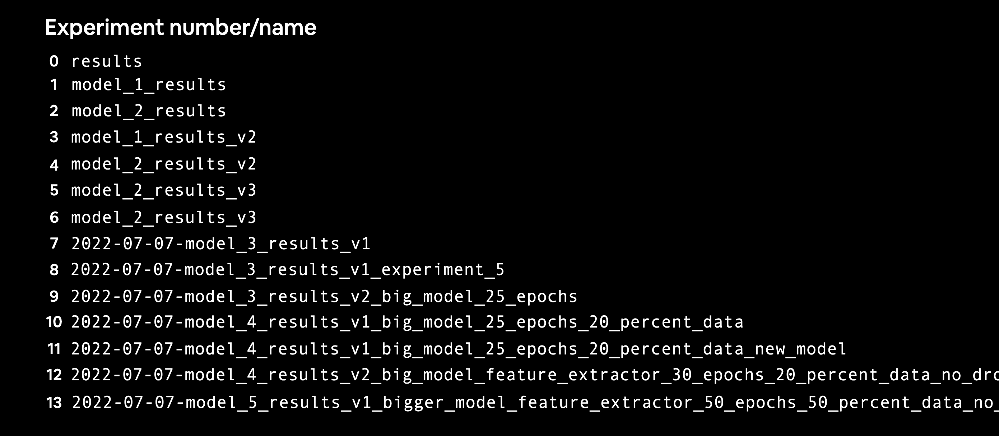

## *Different ways to track machine learning experiments*
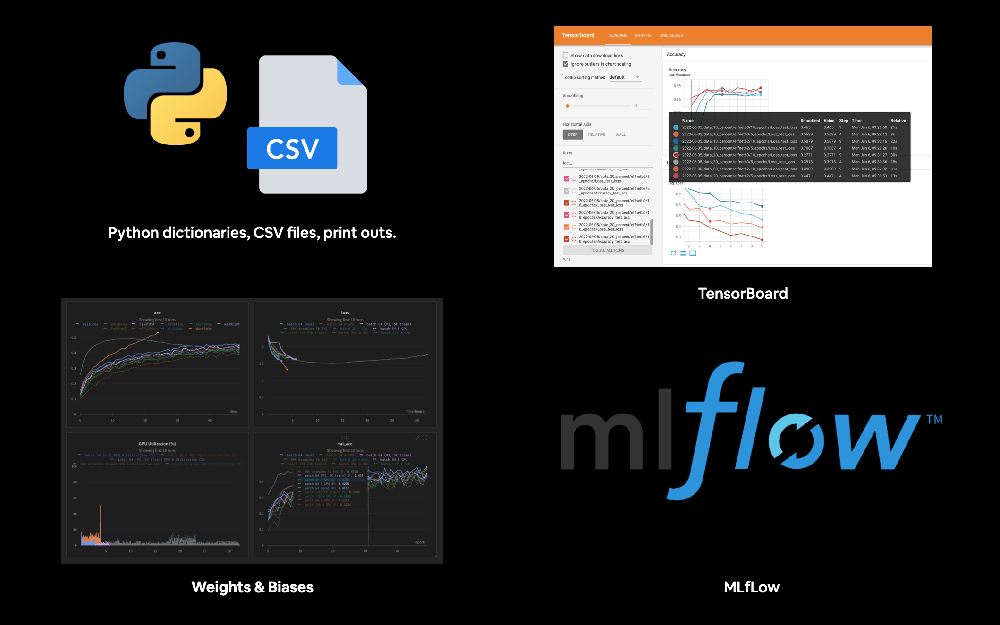

## *Getting setup*

In [ ]:
try:
  import torch
  import torchvision
  assert int(torch.__version__.split(".")[1]) >= 12
  assert int(torchvision.__version__.split(".")[1]) >= 12
  print(f"torch version:{torch.__version__}")
  print(f"torchvision version:{torchvision.__version__}")

except:
  print("[INFO] torch/torchvision versions not as required, installing nightly versions.")
  !pip install -U torch torchvision torchaudio --extra-index-url https://download.pytorch.org/whl/cu113
  import torch
  import torchvision
  print(f"torch version:{torch.__version__}")
  print(f"torchvision version:{torchvision.__version__}")

## *Create a helper function and set seeds*

In [ ]:
import matplotlib.pyplot as plt
import torch
import torchvision

from torch import nn
from torchvision import transforms

try:
  from torchinfo import summary
except:
  print("[INFO] couldn't find torchinfo, installing it..")
  !pip install torchinfo
  from torchinfo import summary

try:
  from going_modular.going_modular import data_setup, engine
except:
  print("[INFO] couldn't find going_modular scripts, downloading them from Github..")
  !git clone https://github.com/mrdbourke/pytorch-deep-learning
  !mv pytorch-deep-learning/going_modular .
  !rm -rf pytorch-deep-learning
  from going_modular.going_modular import data_setup, engine

[INFO] couldn't find torchinfo, installing it..
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
[INFO] couldn't find going_modular scripts, downloading them from Github..
Cloning into 'pytorch-deep-learning'...
remote: Enumerating objects: 3426, done.
remote: Counting objects: 100% (124/124), done.
remote: Compressing objects: 100% (75/75), done.
remote: Total 3426 (delta 52), reused 100 (delta 44), pack-reused 3302
Receiving objects: 100% (3426/3426), 643.48 MiB | 24.60 MiB/s, done.
Resolving deltas: 100% (1959/1959), done.
Updating files: 100% (222/222), done.


In [ ]:
device= "cuda" if torch.cuda.is_available() else "cpu"
device

'cuda'

In [ ]:
def set_seeds(seed:int= 44):
  
  torch.manual_seed(seed)
  torch.cuda.manual_seed(seed)

## *Getting data*

In [ ]:
import os
import requests

from zipfile import ZipFile
from pathlib import Path

def download_data(source:str, destination:str, remove_source: bool= True) -> Path:
   
   data_path= Path("data/")
   image_path= data_path/ destination

   if image_path.is_dir():
     print(f"{image_path} directory already exists, skipping download.")
   else:
     print(f"Didn't find {image_path} directory, creating one.")
     image_path.mkdir(parents= True, exist_ok= True)

     target_file= Path(source).name
     with open(data_path/ target_file, "wb") as f:
       print(f"Downloading {target_file} from {source}..")
       request= requests.get(source)
       f.write(request.content)

     with ZipFile(data_path/ target_file, "r") as zip_ref:

        print(f"Extracting {target_file}")
        zip_ref.extractall(image_path)

     if remove_source:
        os.remove(data_path/ target_file)

   return image_path


image_path= download_data(source="https://github.com/mrdbourke/pytorch-deep-learning/raw/main/data/pizza_steak_sushi.zip", destination= 'pizza_steak_sushi' )

image_path

Didn't find data/pizza_steak_sushi directory, creating one.
Extracting pizza_steak_sushi.zip


PosixPath('data/pizza_steak_sushi')

## *Perform manual transforms and  thus create dataloaders*

In [ ]:
train_dir= image_path/ "train"
test_dir= image_path/ "test"

normalize= transforms.Normalize(mean= [0.485, 0.456, 0.406], std= [0.229, 0.224, 0.225])

manual_transforms= transforms.Compose([transforms.Resize((224,224)), transforms.ToTensor(), normalize])

print(manual_transforms)

train_dataloader, test_dataloader, class_names= data_setup.create_dataloaders(train_dir= train_dir, test_dir= test_dir,transform= manual_transforms, batch_size= 32)

train_dataloader,class_names




Compose(
    Resize(size=(224, 224), interpolation=bilinear, max_size=None, antialias=None)
    ToTensor()
    Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
)


(<torch.utils.data.dataloader.DataLoader at 0x7f79845835e0>,
 ['pizza', 'steak', 'sushi'])

## *perform automatic transforms and create dataloaders*

In [ ]:
train_dir= image_path/ "train"
test_dir= image_path/ "test"

weights= torchvision.models.EfficientNet_B0_Weights.DEFAULT
automatic_transforms= weights.transforms()
print(automatic_transforms)

train_dataloader, test_dataloader, class_names= data_setup.create_dataloaders(train_dir= train_dir, test_dir= test_dir, transform= automatic_transforms,
                                                                              batch_size= 32)
train_dataloader, class_names


ImageClassification(
    crop_size=[224]
    resize_size=[256]
    mean=[0.485, 0.456, 0.406]
    std=[0.229, 0.224, 0.225]
    interpolation=InterpolationMode.BICUBIC
)


(<torch.utils.data.dataloader.DataLoader at 0x7f7a202a4f10>,
 ['pizza', 'steak', 'sushi'])

## *Getting a pretrained model with freezing the base layers and changing the classifier head*

In [ ]:
weights= torchvision.models.EfficientNet_B0_Weights.DEFAULT
model= torchvision.models.efficientnet_b0(weights= weights).to(device)
#model

In [ ]:
for param in model.features.parameters():
  param.requires_grad= False


model.classifier= nn.Sequential(
    
    nn.Dropout(0.2),
    nn.Linear(in_features= 1280, out_features= len(class_names))
).to(device)

In [ ]:
from torchinfo import summary
summary(model, input_size= [32,3,224,224],col_names= ["input_size", "output_size","num_params","trainable"], col_width= 20,
        row_settings= ["var_names"])

Layer (type (var_name))                                      Input Shape          Output Shape         Param #              Trainable
EfficientNet (EfficientNet)                                  [32, 3, 224, 224]    [32, 3]              --                   Partial
├─Sequential (features)                                      [32, 3, 224, 224]    [32, 1280, 7, 7]     --                   False
│    └─Conv2dNormActivation (0)                              [32, 3, 224, 224]    [32, 32, 112, 112]   --                   False
│    │    └─Conv2d (0)                                       [32, 3, 224, 224]    [32, 32, 112, 112]   (864)                False
│    │    └─BatchNorm2d (1)                                  [32, 32, 112, 112]   [32, 32, 112, 112]   (64)                 False
│    │    └─SiLU (2)                                         [32, 32, 112, 112]   [32, 32, 112, 112]   --                   --
│    └─Sequential (1)                                        [32, 32, 112, 112]   [32, 

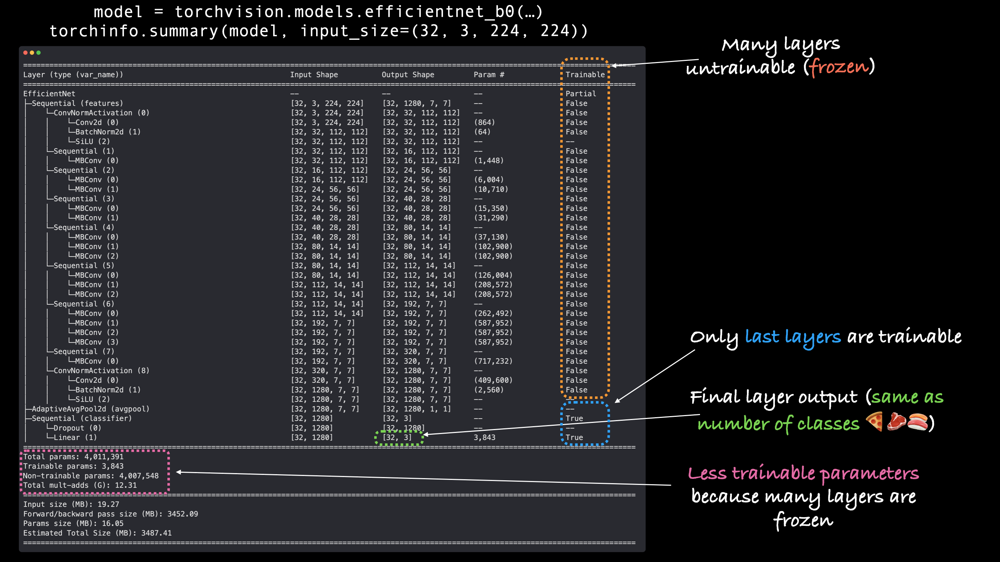

## *Train model and track results*

In [ ]:
loss_fn= nn.CrossEntropyLoss()
optimizer= torch.optim.Adam(model.parameters(), lr= 0.001)

## *Adjust train function to track results with summarywriter*

In [ ]:
from torch.utils.tensorboard import SummaryWriter
writer= SummaryWriter()

In [ ]:
from typing import Dict, List
from tqdm.auto import tqdm
from going_modular.going_modular.engine import train_step, test_step

def train(model:torch.nn.Module, train_dataloader:torch.utils.data.DataLoader, test_dataloader: torch.utils.data.DataLoader, optimizer:torch.optim.Optimizer,
          loss_fn: torch.nn.Module, epochs: int,
          device: torch.device)-> Dict[str,List]:


          results= {
              
              "train_loss":[],
              "train_acc":[],
              "test_loss":[],
              "test_acc":[]
          }

          for epoch in tqdm(range(epochs)):
            train_loss, train_acc= train_step(model= model, dataloader= train_dataloader, loss_fn= loss_fn, optimizer= optimizer, device= device)
            test_loss, test_acc= test_step(model= model, dataloader= test_dataloader, loss_fn= loss_fn, device= device)

            print(
                f"Epoch: {epoch+ 1}|"
                f"Train loss:{train_loss:.4f}|"
                f"Train acc:{train_acc:.4f}|"
                f"Test loss:{test_loss:.4f}|"
                f"Test acc:{test_acc:.4f}"
            )

            results["train_loss"].append(train_loss)
            results["train_acc"].append(train_acc)
            results["test_loss"].append(test_loss)
            results["test_acc"].append(test_acc)

            writer.add_scalars(main_tag= "Loss", tag_scalar_dict= {"train_loss": train_loss, "test_loss":test_loss}, global_step= epoch)
            writer.add_scalars(main_tag= "Accuracy", tag_scalar_dict= {"train_acc": train_acc, "test_acc":test_acc}, global_step= epoch)
            writer.add_graph(model= model, input_to_model= torch.randn(32,3,224,224).to(device))
          
          writer.close()

          return results



In [ ]:
results= train(model= model, train_dataloader= train_dataloader, test_dataloader= test_dataloader, 
               optimizer= optimizer, loss_fn= loss_fn, epochs= 5, device= device)

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 1|Train loss:1.0379|Train acc:0.4883|Test loss:0.8698|Test acc:0.7121
Epoch: 2|Train loss:0.9219|Train acc:0.6055|Test loss:0.7424|Test acc:0.8864
Epoch: 3|Train loss:0.7507|Train acc:0.8359|Test loss:0.7432|Test acc:0.7528
Epoch: 4|Train loss:0.7498|Train acc:0.7266|Test loss:0.7541|Test acc:0.6316
Epoch: 5|Train loss:0.5876|Train acc:0.9297|Test loss:0.7093|Test acc:0.6932


## *View our models results in Tensorboard*

In [ ]:
results

{'train_loss': [1.0379113405942917,
  0.921856477856636,
  0.7507295906543732,
  0.749834880232811,
  0.5876067578792572],
 'train_acc': [0.48828125, 0.60546875, 0.8359375, 0.7265625, 0.9296875],
 'test_loss': [0.8698258797327677,
  0.7423759698867798,
  0.7431771755218506,
  0.7541036605834961,
  0.7092721263567606],
 'test_acc': [0.712121212121212,
  0.8863636363636364,
  0.7528409090909092,
  0.631628787878788,
  0.6931818181818182]}

In [ ]:
%load_ext tensorboard
%tensorboard --logdir runs

Output hidden; open in https://colab.research.google.com to view.

## *Create a helper function to build summarywriter instances*

In [ ]:
def create_writer(experiment_name: str, model_name: str, extra: str= None)->torch.utils.tensorboard.writer.SummaryWriter():

  from datetime import datetime
  import os
  timestamp= datetime.now().strftime("%Y-%m-%d")

  if extra:
    log_dir= os.path.join("runs", timestamp, experiment_name, model_name, extra)

  else:
    log_dir= os.path.join("runs", timestamp, experiment_name, model_name)

  print(f"[INFO] created SummaryWriter, saving to {log_dir}")
  return SummaryWriter(log_dir= log_dir)


In [ ]:
example_writer= create_writer(experiment_name= "data_10_percent", model_name= "effnetb0", extra= "5_epochs")

[INFO] created SummaryWriter, saving to runs/2023-02-15/data_10_percent/effnetb0/5_epochs


## *Update the train() function to include a writer parameter*

In [ ]:
from typing import Dict, List
from tqdm.auto import tqdm

def train(model:torch.nn.Module,train_dataloader: torch.utils.data.DataLoader, test_dataloader:torch.utils.data.DataLoader,
          optimizer: torch.optim.Optimizer, epochs: int, loss_fn: torch.nn.Module, device: torch.device,
          writer: torch.utils.tensorboard.writer.SummaryWriter)-> Dict[str, List]:

          results= {
              "train_loss":[],
              "train_acc":[],
              "test_loss":[],
              "test_acc":[]
              
          }


          for epoch in tqdm(range(epochs)):

            train_loss, train_acc= train_step(model= model, dataloader= train_dataloader, loss_fn= loss_fn, optimizer= optimizer, device= device)
            test_loss, test_acc= test_step(model= model, dataloader= train_dataloader, loss_fn= loss_fn, device= device)


            print(f"Epoch:{epoch + 1}|"
            f"train_loss:{train_loss:.4f}|" 
            f" train_acc:{train_acc:.4f}|)"
            f"test_loss:{test_loss:.4f}|"
            f"test_acc: {test_acc:.4f}|")


            results["train_loss"].append(train_loss)
            results["train_acc"].append(train_acc)
            results["test_loss"].append(test_loss)
            results["test_acc"].append(test_acc)

            if writer:
              writer.add_scalars(main_tag= "Loss", tag_scalar_dict={"train_loss":train_loss,
                                                                    "test_loss":test_loss}, global_step= epoch)
              
              writer.add_scalars(main_tag= "Accuracy", tag_scalar_dict={"train_acc":train_acc,
                                                                    "test_acc":test_acc}, global_step= epoch)
              
              writer.close()

            else:
              pass

          return results

            

## *Download different datasets*

In [ ]:
data_10_percent_path= download_data(source= "https://github.com/mrdbourke/pytorch-deep-learning/raw/main/data/pizza_steak_sushi.zip", destination= "pizza_steak_sushi")
data_20_percent_path= download_data(source= "https://github.com/mrdbourke/pytorch-deep-learning/raw/main/data/pizza_steak_sushi_20_percent.zip", destination= "pizza_steak_sushi_20_percent")


data/pizza_steak_sushi directory already exists, skipping download.
Didn't find data/pizza_steak_sushi_20_percent directory, creating one.
Extracting pizza_steak_sushi_20_percent.zip


In [ ]:
train_dir_10_percent= data_10_percent_path/ "train"
train_dir_20_percent= data_20_percent_path/ "train"

print(train_dir_10_percent)
print(train_dir_20_percent)

data/pizza_steak_sushi/train
data/pizza_steak_sushi_20_percent/train


## *Perform transforms and create dataloaders*

In [ ]:
from torchvision import transforms

normalize= transforms.Normalize(mean=[0.485,0.456,0.406], std= [0.229, 0.225, 0.224])

simple_transform= transforms.Compose([transforms.Resize((224,224)), transforms.ToTensor(), normalize])



In [ ]:
BATCH_SIZE= 32

train_dataloader_10_percent, test_dataloader, class_names= data_setup.create_dataloaders( train_dir= train_dir_10_percent, test_dir= test_dir, transform= simple_transform,
                                                                                         batch_size= BATCH_SIZE)


train_dataloader_20_percent, test_dataloader, class_names= data_setup.create_dataloaders( train_dir= train_dir_20_percent, test_dir= test_dir, transform= simple_transform,
                                                                                         batch_size= BATCH_SIZE)

print(f"Number of batches in 10_percent_train_data: {len(train_dataloader_10_percent)}")
print(f"Number of batches in 20_percent_train_data: {len(train_dataloader_20_percent)}")
print(f"Class names: {class_names}")


Number of batches in 10_percent_train_data: 8
Number of batches in 20_percent_train_data: 15
Class names: ['pizza', 'steak', 'sushi']


## *Create feature extractor model*

In [ ]:
import torchvision
from torchinfo import summary

efficientnetb2_weights= torchvision.models.EfficientNet_B2_Weights.DEFAULT
effnetb2= torchvision.models.efficientnet_b2(efficientnetb2_weights)

summary(model= effnetb2, input_size=(32,3,224,224), col_names= ["input_size", "output_size", "num_params", "trainable"], col_width= 18, row_settings= ["var_names"])
#print(f"No of in_features of classifier in EfficientNet_b2: {len(effnetb2.classifier.state_dict()['1.weight'][0])}")


Layer (type (var_name))                                      Input Shape        Output Shape       Param #            Trainable
EfficientNet (EfficientNet)                                  [32, 3, 224, 224]  [32, 1000]         --                 True
├─Sequential (features)                                      [32, 3, 224, 224]  [32, 1408, 7, 7]   --                 True
│    └─Conv2dNormActivation (0)                              [32, 3, 224, 224]  [32, 32, 112, 112] --                 True
│    │    └─Conv2d (0)                                       [32, 3, 224, 224]  [32, 32, 112, 112] 864                True
│    │    └─BatchNorm2d (1)                                  [32, 32, 112, 112] [32, 32, 112, 112] 64                 True
│    │    └─SiLU (2)                                         [32, 32, 112, 112] [32, 32, 112, 112] --                 --
│    └─Sequential (1)                                        [32, 32, 112, 112] [32, 16, 112, 112] --                 True
│    │    └─M

In [ ]:
import torchvision
from torch import nn

def create_effnetb0():
  weights= torchvision.models.EfficientNet_B0_Weights.DEFAULT
  model= torchvision.models.efficientnet_b0(weights= weights).to(device)

  for param in model.features.parameters():
    param.requires_grad= False

  set_seeds()

  model.classifier= nn.Sequential(
      
      nn.Dropout(0.2),
      nn.Linear(in_features= 1280, out_features= len(class_names))

  ).to(device)

  model.name= "effnetb0"
  print(f"[INFO] created new {model.name} model.")
  return model



def create_effnetb2():

  weights= torchvision.models.EfficientNet_B2_Weights.DEFAULT
  model= torchvision.models.efficientnet_b2(weights).to(device)

  for param in model.features.parameters():
    param.requires_grad= False

  set_seeds()

  model.classifier= nn.Sequential(
      
      nn.Dropout(0.3),
      nn.Linear(in_features= 1408, out_features= len(class_names))

  ).to(device)

  model.name= "effnetb2"
  print(f"[INFO] created a new {model.name} model.")
  return model



In [ ]:
effnetb0= create_effnetb0()

summary(model= effnetb0, input_size= (32,3,224,224),col_names= ["input_size", "output_size", "num_params", "trainable"], col_width= 20, row_settings= ["var_names"])

[INFO] created new effnetb0 model.


Layer (type (var_name))                                      Input Shape          Output Shape         Param #              Trainable
EfficientNet (EfficientNet)                                  [32, 3, 224, 224]    [32, 3]              --                   Partial
├─Sequential (features)                                      [32, 3, 224, 224]    [32, 1280, 7, 7]     --                   False
│    └─Conv2dNormActivation (0)                              [32, 3, 224, 224]    [32, 32, 112, 112]   --                   False
│    │    └─Conv2d (0)                                       [32, 3, 224, 224]    [32, 32, 112, 112]   (864)                False
│    │    └─BatchNorm2d (1)                                  [32, 32, 112, 112]   [32, 32, 112, 112]   (64)                 False
│    │    └─SiLU (2)                                         [32, 32, 112, 112]   [32, 32, 112, 112]   --                   --
│    └─Sequential (1)                                        [32, 32, 112, 112]   [32, 

In [ ]:
effnetb2= create_effnetb2()

summary(model= effnetb2, input_size= (32, 3, 224, 224),col_names= ["input_size", "output_size", "num_params", "trainable"], col_width= 20, row_settings= ["var_names"])

[INFO] created a new effnetb2 model.


Layer (type (var_name))                                      Input Shape          Output Shape         Param #              Trainable
EfficientNet (EfficientNet)                                  [32, 3, 224, 224]    [32, 3]              --                   Partial
├─Sequential (features)                                      [32, 3, 224, 224]    [32, 1408, 7, 7]     --                   False
│    └─Conv2dNormActivation (0)                              [32, 3, 224, 224]    [32, 32, 112, 112]   --                   False
│    │    └─Conv2d (0)                                       [32, 3, 224, 224]    [32, 32, 112, 112]   (864)                False
│    │    └─BatchNorm2d (1)                                  [32, 32, 112, 112]   [32, 32, 112, 112]   (64)                 False
│    │    └─SiLU (2)                                         [32, 32, 112, 112]   [32, 32, 112, 112]   --                   --
│    └─Sequential (1)                                        [32, 32, 112, 112]   [32, 

In [ ]:
num_epochs= [5, 10]

models= ["effnetb0","effnetb2"]

train_dataloaders= {"data_10_percent": train_dataloader_10_percent,
                    "data_20_percent": train_dataloader_20_percent    
}

In [ ]:
%%time

from going_modular.going_modular.utils import save_model
set_seeds()

experiment_number= 0

for dataloader_name, train_dataloader in train_dataloaders.items():

  for epochs in num_epochs:

    for model_name in models:

      experiment_number += 1
      print(f"[INFO] Experiment number:{experiment_number}")
      print(f"[INFO] Model:{model_name}")
      print(f"[INFO] Dataloader:{dataloader_name}")
      print(f"[INFO] No. Epochs:{epochs}")

      if model_name== "effnetb0":
        model= create_effnetb0()
      else:
        model= create_effnetb2()

      loss_fn= nn.CrossEntropyLoss()
      optimizer= torch.optim.Adam(params= model.parameters(), lr= 0.001)

      train(model= model, train_dataloader= train_dataloader, test_dataloader= test_dataloader, optimizer= optimizer, loss_fn= loss_fn, 
            epochs= epochs, device= device, writer= create_writer(experiment_name= dataloader_name, model_name= model_name, extra= f"{epochs}_epochs"))
      
      save_filepath= f"07_{model_name}_{dataloader_name}_{epochs}_epochs.pth"
      save_model(model= model, target_dir= "models", model_name= save_filepath)
      print("-"* 50 + "\n")




[INFO] Experiment number:1
[INFO] Model:effnetb0
[INFO] Dataloader:data_10_percent
[INFO] No. Epochs:5
[INFO] created new effnetb0 model.
[INFO] created SummaryWriter, saving to runs/2023-02-15/data_10_percent/effnetb0/5_epochs


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch:1|train_loss:1.0346| train_acc:0.5664|)test_loss:0.7788|test_acc: 0.8281|
Epoch:2|train_loss:0.8958| train_acc:0.5508|)test_loss:0.7192|test_acc: 0.6797|
Epoch:3|train_loss:0.7398| train_acc:0.8125|)test_loss:0.5906|test_acc: 0.9180|
Epoch:4|train_loss:0.7475| train_acc:0.6719|)test_loss:0.5087|test_acc: 0.9023|
Epoch:5|train_loss:0.6062| train_acc:0.7891|)test_loss:0.4561|test_acc: 0.9414|
[INFO] Saving model to: models/07_effnetb0_data_10_percent_5_epochs.pth
--------------------------------------------------

[INFO] Experiment number:2
[INFO] Model:effnetb2
[INFO] Dataloader:data_10_percent
[INFO] No. Epochs:5
[INFO] created a new effnetb2 model.
[INFO] created SummaryWriter, saving to runs/2023-02-15/data_10_percent/effnetb2/5_epochs


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch:1|train_loss:1.0835| train_acc:0.4688|)test_loss:0.9617|test_acc: 0.7461|
Epoch:2|train_loss:0.9974| train_acc:0.5000|)test_loss:0.7597|test_acc: 0.7109|
Epoch:3|train_loss:0.8423| train_acc:0.6055|)test_loss:0.6461|test_acc: 0.9414|
Epoch:4|train_loss:0.7237| train_acc:0.7344|)test_loss:0.6386|test_acc: 0.9414|
Epoch:5|train_loss:0.7117| train_acc:0.7422|)test_loss:0.5583|test_acc: 0.9414|
[INFO] Saving model to: models/07_effnetb2_data_10_percent_5_epochs.pth
--------------------------------------------------

[INFO] Experiment number:3
[INFO] Model:effnetb0
[INFO] Dataloader:data_10_percent
[INFO] No. Epochs:10
[INFO] created new effnetb0 model.
[INFO] created SummaryWriter, saving to runs/2023-02-15/data_10_percent/effnetb0/10_epochs


  0%|          | 0/10 [00:00<?, ?it/s]

Epoch:1|train_loss:1.0346| train_acc:0.5664|)test_loss:0.7788|test_acc: 0.8281|
Epoch:2|train_loss:0.8958| train_acc:0.5508|)test_loss:0.7192|test_acc: 0.6797|
Epoch:3|train_loss:0.7398| train_acc:0.8125|)test_loss:0.5906|test_acc: 0.9180|
Epoch:4|train_loss:0.7475| train_acc:0.6719|)test_loss:0.5087|test_acc: 0.9023|
Epoch:5|train_loss:0.6062| train_acc:0.7891|)test_loss:0.4561|test_acc: 0.9414|
Epoch:6|train_loss:0.5446| train_acc:0.9062|)test_loss:0.4524|test_acc: 0.9609|
Epoch:7|train_loss:0.5955| train_acc:0.7812|)test_loss:0.4621|test_acc: 0.9570|
Epoch:8|train_loss:0.5014| train_acc:0.9336|)test_loss:0.4347|test_acc: 0.9688|
Epoch:9|train_loss:0.5440| train_acc:0.8086|)test_loss:0.4382|test_acc: 0.9609|
Epoch:10|train_loss:0.4731| train_acc:0.9414|)test_loss:0.3273|test_acc: 0.9805|
[INFO] Saving model to: models/07_effnetb0_data_10_percent_10_epochs.pth
--------------------------------------------------

[INFO] Experiment number:4
[INFO] Model:effnetb2
[INFO] Dataloader:data_10

  0%|          | 0/10 [00:00<?, ?it/s]

Epoch:1|train_loss:1.0835| train_acc:0.4688|)test_loss:0.9617|test_acc: 0.7461|
Epoch:2|train_loss:0.9974| train_acc:0.5000|)test_loss:0.7597|test_acc: 0.7109|
Epoch:3|train_loss:0.8423| train_acc:0.6055|)test_loss:0.6461|test_acc: 0.9414|
Epoch:4|train_loss:0.7237| train_acc:0.7344|)test_loss:0.6386|test_acc: 0.9414|
Epoch:5|train_loss:0.7117| train_acc:0.7422|)test_loss:0.5583|test_acc: 0.9414|
Epoch:6|train_loss:0.6282| train_acc:0.8008|)test_loss:0.5192|test_acc: 0.9531|
Epoch:7|train_loss:0.5493| train_acc:0.9180|)test_loss:0.4725|test_acc: 0.9648|
Epoch:8|train_loss:0.5539| train_acc:0.7695|)test_loss:0.5074|test_acc: 0.9688|
Epoch:9|train_loss:0.4941| train_acc:0.9141|)test_loss:0.4194|test_acc: 0.9766|
Epoch:10|train_loss:0.4256| train_acc:0.9258|)test_loss:0.3630|test_acc: 0.9688|
[INFO] Saving model to: models/07_effnetb2_data_10_percent_10_epochs.pth
--------------------------------------------------

[INFO] Experiment number:5
[INFO] Model:effnetb0
[INFO] Dataloader:data_20

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch:1|train_loss:0.9476| train_acc:0.6125|)test_loss:0.6565|test_acc: 0.8833|
Epoch:2|train_loss:0.6814| train_acc:0.8354|)test_loss:0.5021|test_acc: 0.9333|
Epoch:3|train_loss:0.5306| train_acc:0.8938|)test_loss:0.4103|test_acc: 0.9292|
Epoch:4|train_loss:0.4707| train_acc:0.8500|)test_loss:0.3601|test_acc: 0.9437|
Epoch:5|train_loss:0.3975| train_acc:0.8875|)test_loss:0.3531|test_acc: 0.9104|
[INFO] Saving model to: models/07_effnetb0_data_20_percent_5_epochs.pth
--------------------------------------------------

[INFO] Experiment number:6
[INFO] Model:effnetb2
[INFO] Dataloader:data_20_percent
[INFO] No. Epochs:5
[INFO] created a new effnetb2 model.
[INFO] created SummaryWriter, saving to runs/2023-02-15/data_20_percent/effnetb2/5_epochs


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch:1|train_loss:1.0083| train_acc:0.5083|)test_loss:0.7906|test_acc: 0.8562|
Epoch:2|train_loss:0.7571| train_acc:0.8125|)test_loss:0.6210|test_acc: 0.9313|
Epoch:3|train_loss:0.6194| train_acc:0.8250|)test_loss:0.5400|test_acc: 0.8688|
Epoch:4|train_loss:0.5379| train_acc:0.8271|)test_loss:0.4332|test_acc: 0.9500|
Epoch:5|train_loss:0.5546| train_acc:0.8458|)test_loss:0.3958|test_acc: 0.9479|
[INFO] Saving model to: models/07_effnetb2_data_20_percent_5_epochs.pth
--------------------------------------------------

[INFO] Experiment number:7
[INFO] Model:effnetb0
[INFO] Dataloader:data_20_percent
[INFO] No. Epochs:10
[INFO] created new effnetb0 model.
[INFO] created SummaryWriter, saving to runs/2023-02-15/data_20_percent/effnetb0/10_epochs


  0%|          | 0/10 [00:00<?, ?it/s]

Epoch:1|train_loss:0.9476| train_acc:0.6125|)test_loss:0.6565|test_acc: 0.8833|
Epoch:2|train_loss:0.6814| train_acc:0.8354|)test_loss:0.5021|test_acc: 0.9333|
Epoch:3|train_loss:0.5306| train_acc:0.8938|)test_loss:0.4103|test_acc: 0.9292|
Epoch:4|train_loss:0.4707| train_acc:0.8500|)test_loss:0.3601|test_acc: 0.9437|
Epoch:5|train_loss:0.3975| train_acc:0.8875|)test_loss:0.3531|test_acc: 0.9104|
Epoch:6|train_loss:0.4511| train_acc:0.8354|)test_loss:0.3090|test_acc: 0.9437|
Epoch:7|train_loss:0.3417| train_acc:0.9125|)test_loss:0.2902|test_acc: 0.9500|
Epoch:8|train_loss:0.3569| train_acc:0.8792|)test_loss:0.2417|test_acc: 0.9604|
Epoch:9|train_loss:0.3404| train_acc:0.9000|)test_loss:0.2540|test_acc: 0.9625|
Epoch:10|train_loss:0.3577| train_acc:0.8938|)test_loss:0.2246|test_acc: 0.9625|
[INFO] Saving model to: models/07_effnetb0_data_20_percent_10_epochs.pth
--------------------------------------------------

[INFO] Experiment number:8
[INFO] Model:effnetb2
[INFO] Dataloader:data_20

  0%|          | 0/10 [00:00<?, ?it/s]

Epoch:1|train_loss:1.0083| train_acc:0.5083|)test_loss:0.7906|test_acc: 0.8562|
Epoch:2|train_loss:0.7571| train_acc:0.8125|)test_loss:0.6210|test_acc: 0.9313|
Epoch:3|train_loss:0.6194| train_acc:0.8250|)test_loss:0.5400|test_acc: 0.8688|
Epoch:4|train_loss:0.5379| train_acc:0.8271|)test_loss:0.4332|test_acc: 0.9500|
Epoch:5|train_loss:0.5546| train_acc:0.8458|)test_loss:0.3958|test_acc: 0.9479|
Epoch:6|train_loss:0.4458| train_acc:0.8729|)test_loss:0.3743|test_acc: 0.9521|
Epoch:7|train_loss:0.4167| train_acc:0.8917|)test_loss:0.3199|test_acc: 0.9688|
Epoch:8|train_loss:0.3574| train_acc:0.9167|)test_loss:0.3114|test_acc: 0.9583|
Epoch:9|train_loss:0.3021| train_acc:0.9354|)test_loss:0.2713|test_acc: 0.9688|
Epoch:10|train_loss:0.3317| train_acc:0.8792|)test_loss:0.2540|test_acc: 0.9667|
[INFO] Saving model to: models/07_effnetb2_data_20_percent_10_epochs.pth
--------------------------------------------------

CPU times: user 57 s, sys: 18.4 s, total: 1min 15s
Wall time: 4min 45s


## *View experiments in Tensorboard*

In [ ]:
from torch.utils import tensorboard
%load_ext tensorboard
%tensorboard --logdir runs

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
!tensorboard dev upload --logdir runs \
     --name "07. Pytorch Experiment Tracking: Foodvision Mini model results " \
     --description: "Comparing results of different model size, training data amount and training time."

2023-02-15 04:22:14.451658: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-02-15 04:22:14.451754: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-02-15 04:22:14.451770: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Cannot dlopen some TensorRT libraries. If you would like to use Nvidia GPU with TensorRT, please make sure the missing libraries mentioned above are installed properly.
usage: tensorboard
       [-h]
       [--helpfull]
       {serve,dev}
       ...
tensorboard: error: unrecognized arguments: --description: Comparing results of differ

## *Load the best model and make predictions*

In [ ]:
best_model_path= '/content/models/07_effnetb2_data_20_percent_5_epochs.pth'
best_model= create_effnetb2()
best_model.load_state_dict(torch.load(best_model_path))

In [ ]:
from pathlib import Path

effnetb2_model_size= Path(best_model_path).stat().st_size // (1024 *1024)
print(f"Effnet_b2 feature extractor model size: {effnetb2_model_size} MB.")

In [ ]:
import random
from going_modular.going_modular.predictions import pred_and_plot_image

number_of_images= 3
test_image_path_list= list(Path(data_20_percent_path/ "test").glob("*/*.jpg"))
test_image_sample= random.sample(population= test_image_path_list, k= number_of_images)

for image_path in test_image_sample:
  pred_and_plot_image(model= best_model,image_path= image_path, class_names= class_names, image_size= ((224,224)))


## *Predict on a custom image with the best model*

data/ pizza_dad.jpeg already exists, skippinf download.


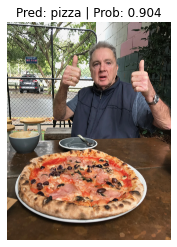

In [ ]:
import requests

custom_image_path= Path("data/ pizza_dad.jpeg")

if not custom_image_path.is_file():
  with open(custom_image_path, "wb") as f:
    request= requests.get("https://raw.githubusercontent.com/mrdbourke/pytorch-deep-learning/main/images/04-pizza-dad.jpeg")
    f.write(request.content)

else:
  print(f"{custom_image_path} already exists, skippinf download.")

pred_and_plot_image(model= best_model, image_path= custom_image_path, class_names= class_names)

